In [1]:
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
#pip install pandas_ta

In [3]:
import pandas_ta as ta

In [4]:
import random
import math
import os
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

In [5]:
# Everything concerning USDTRY pair is done here, after testing the models CHECK THIS PART!
bist_daily = pd.read_csv("datasets/bist_100_daily.csv")
usdtry_daily = pd.read_csv('datasets/USDTRY_daily.csv')
usdtry_daily = usdtry_daily[["Date","USDTRY_Close"]]
usdtry_daily["Date"]=pd.to_datetime(usdtry_daily["Date"])
bist_daily["Date"] = pd.to_datetime(bist_daily["Date"])
bist_daily = bist_daily.merge(usdtry_daily, how='inner',on="Date")


# Extract the number of rows and columns by using the shape of the data.
numRows,numColumns = bist_daily.shape
# Extract the time interval.
last_date, first_date = bist_daily.iloc[0].Date, bist_daily.iloc[-1].Date
# Check the availability of the data.
na_cols = bist_daily.columns[bist_daily.isna().any()].tolist()

# Print the information.
print(f"There are {numRows} rows and {numColumns} columns in the initial dataset.")
print(f"The data represents the time frame between the dates '{last_date}' and '{first_date}'.")
if not na_cols:
    print("There are no NA rows.")
else:
    print(f"Columns in the dataset which include NA rows: {na_cols}.")
# Convert columns to numeric values
column_names = ["Price", "Open", "High", "Low"]
for column in column_names:
    bist_daily[column] = bist_daily[column].str.replace(',', '')
    bist_daily[column] = pd.to_numeric(bist_daily[column])
# CONVERT TO DATETIME FORMAT AND SORT DATA BY DATE
bist_daily.Date = pd.to_datetime(bist_daily.Date)
bist_daily.sort_values(by="Date", ignore_index=True,inplace=True)
bist_daily.set_index(pd.DatetimeIndex(bist_daily["Date"]), inplace=True)
bist_daily.rename(columns={"Price": "close"},inplace=True)
# Calculate Returns and append to the df DataFrame
# CUMLOGRET_1 and CUMPCTRET_1 are added (NaN values exists)
bist_daily.ta.log_return(cumulative=True, append=True)
bist_daily.ta.percent_return(cumulative=True, append=True)
# Returns a list of indicators and utility functions (to check in future)
ind_list = bist_daily.ta.indicators(as_list=True)
# RSI_14, MACD_12_26_9, MACDh_12_26_9 and MACDs_12_26_9 are added (NaN values exists)
bist_daily.ta.rsi(append=True)
bist_daily.ta.macd(append=True)
# SMA values are added (use ta in the future)
sma_values = [5, 10, 15] 
for i in sma_values:
    bist_daily['SMA'+str(i)] = bist_daily['close'].rolling(window=i).mean()
# Remove all NaN value rows
bist_daily.dropna(inplace=True)
bist_daily

There are 4285 rows and 8 columns in the initial dataset.
The data represents the time frame between the dates '2019-12-02 00:00:00' and '2000-01-05 00:00:00'.
There are no NA rows.


,date,close,open,high,low,Vol.,Change %,USDTRY_Close,CUMLOGRET_1,CUMPCTRET_1,RSI_14,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,SMA5,SMA10,SMA15
date,,,,,,,,,,,,,,,,,
2000-02-29,2000-02-29,159.46,153.15,159.46,151.12,38.20M,4.12%,"0,5743",-0.059997,-0.031662,50.482972,-7.536726,2.021502,-9.558229,149.956,150.081,152.436667
2000-03-02,2000-03-02,169.40,171.99,174.08,166.83,60.08M,-1.51%,"0,5592",0.000472,0.030673,57.007643,-5.687707,3.096417,-8.784124,156.942,151.187,153.030000
2000-03-03,2000-03-03,167.84,169.40,170.67,163.96,53.29M,-0.92%,"0,5771",-0.008779,0.021464,55.765721,-4.298673,3.588361,-7.887034,161.206,152.629,153.666000
2000-03-07,2000-03-07,172.23,165.63,172.23,163.13,33.31M,3.98%,"0,6214",0.017040,0.047620,58.505269,-2.811211,4.060658,-6.871869,164.416,154.488,154.749333
2000-03-08,2000-03-08,173.44,172.23,175.01,169.28,44.39M,0.70%,"0,6420",0.024041,0.054646,59.254312,-1.517260,4.283688,-5.800948,168.474,157.263,156.154000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-08-01,2019-08-01,1019.00,1013.42,1021.83,1010.93,1.04B,-0.18%,"5,4811",1.794787,2.848509,56.453510,-2.625148,0.532934,-3.158082,983.092,961.746,988.730667
2019-08-02,2019-08-02,996.79,1015.08,1017.07,996.30,970.54M,-2.18%,"5,2474",1.772750,2.826713,51.628336,-1.558935,1.279317,-2.838253,1001.758,967.324,985.630000
2019-10-01,2019-10-01,1038.77,1052.75,1052.97,1031.89,1.81B,-1.10%,"5,4168",1.814002,2.868828,58.796876,2.643014,4.385014,-1.741999,1010.040,977.668,984.826667


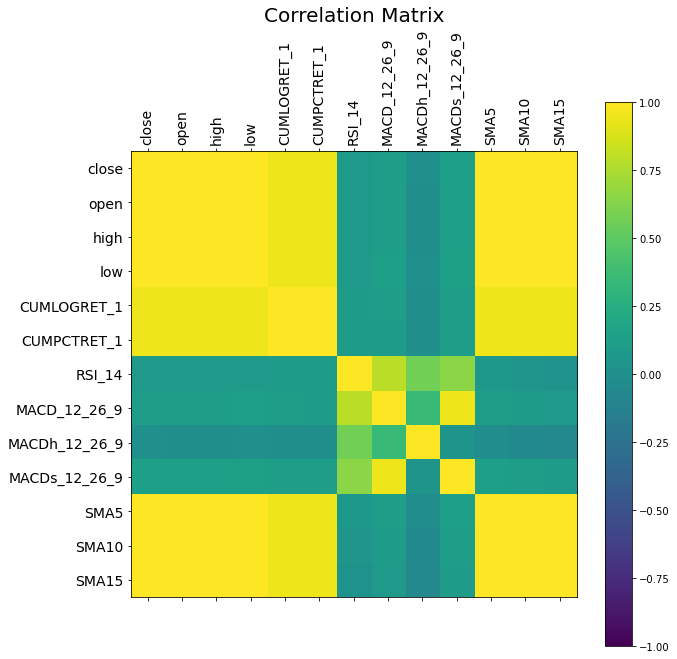

In [6]:
# Visualize the correlation matrix.
fig = plt.figure(figsize=(10,10)) 
ax = fig.add_subplot(111) # 1x1 grid, first subplot.
fig.colorbar(ax.matshow(bist_daily.corr(), vmin=-1, vmax=1)) 
ticks = np.arange(len(bist_daily.corr().columns))
ax.tick_params(axis='x', which='major', labelsize=14, rotation=90)
ax.tick_params(axis='y', which='major', labelsize=14, rotation=0)
ax.set_xticks(ticks)
ax.set_yticks(ticks)
ax.set_xticklabels(bist_daily.corr().columns)
ax.set_yticklabels(bist_daily.corr().columns)
plt.title("Correlation Matrix", fontsize=20)
plt.show()

{1: 2938, 2: 308, 3: 775, 4: 125, 5: 64, 6: 15, 7: 10, 10: 3, 11: 3, 12: 2, 28: 1, 29: 2, 31: 4, 60: 1}


<BarContainer object of 14 artists>

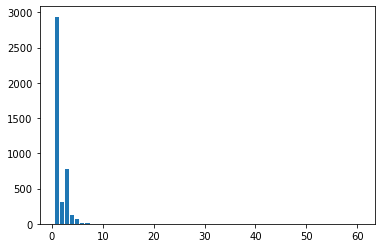

In [7]:
diff = [] 
for date1, date2 in zip(bist_daily["date"][:-1], bist_daily["date"][1:]): 
    diff.append((date2-date1).days) 
unique, counts = np.unique(np.asarray(diff), return_counts=True) 
count_dict = dict(zip(unique, counts)) 
print(count_dict) 
plt.bar(unique,counts)

In [8]:
# edit Vol. column

from operator import itemgetter

vols = bist_daily['Vol.'].to_list()
#[vol[-1] for vol in vols]
#list(filter(lambda vol: "-" in vol,enumerate(vols)))

indexToRemove = bist_daily.iloc[list(map(itemgetter(0),filter(lambda vol: "-" in vol,enumerate(vols))))].index
bist_daily.drop(indexToRemove,inplace=True)
bist_daily['Vol.'] = bist_daily['Vol.'].apply(
    lambda x: float(x[:-1])*(10**6) if x[-1]=="M" else (float(x[:-1])*(10**9) if x[-1]=="B" else "ERROR")).astype("int")
bist_daily

,date,close,open,high,low,Vol.,Change %,USDTRY_Close,CUMLOGRET_1,CUMPCTRET_1,RSI_14,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,SMA5,SMA10,SMA15
date,,,,,,,,,,,,,,,,,
2000-02-29,2000-02-29,159.46,153.15,159.46,151.12,38200000,4.12%,"0,5743",-0.059997,-0.031662,50.482972,-7.536726,2.021502,-9.558229,149.956,150.081,152.436667
2000-03-02,2000-03-02,169.40,171.99,174.08,166.83,60080000,-1.51%,"0,5592",0.000472,0.030673,57.007643,-5.687707,3.096417,-8.784124,156.942,151.187,153.030000
2000-03-03,2000-03-03,167.84,169.40,170.67,163.96,53290000,-0.92%,"0,5771",-0.008779,0.021464,55.765721,-4.298673,3.588361,-7.887034,161.206,152.629,153.666000
2000-03-07,2000-03-07,172.23,165.63,172.23,163.13,33310000,3.98%,"0,6214",0.017040,0.047620,58.505269,-2.811211,4.060658,-6.871869,164.416,154.488,154.749333
2000-03-08,2000-03-08,173.44,172.23,175.01,169.28,44390000,0.70%,"0,6420",0.024041,0.054646,59.254312,-1.517260,4.283688,-5.800948,168.474,157.263,156.154000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-08-01,2019-08-01,1019.00,1013.42,1021.83,1010.93,1040000000,-0.18%,"5,4811",1.794787,2.848509,56.453510,-2.625148,0.532934,-3.158082,983.092,961.746,988.730667
2019-08-02,2019-08-02,996.79,1015.08,1017.07,996.30,970540000,-2.18%,"5,2474",1.772750,2.826713,51.628336,-1.558935,1.279317,-2.838253,1001.758,967.324,985.630000
2019-10-01,2019-10-01,1038.77,1052.75,1052.97,1031.89,1810000000,-1.10%,"5,4168",1.814002,2.868828,58.796876,2.643014,4.385014,-1.741999,1010.040,977.668,984.826667


In [5]:
# seeding an arbitrary number to get same results in multiple runs
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)
print("Seed:", manualSeed)

Seed: 999


In [6]:
# getting number of GPUs from cuda
ngpu = torch.cuda.device_count()
print("Count of available GPUs:", ngpu)

Count of available GPUs: 1


In [7]:
# printing the name of available GPUs
for i in range(ngpu):
    print("GPU {}: {}".format(i+1, torch.cuda.get_device_name(i)))

GPU 1: GeForce RTX 2060


In [8]:
# batch size for the training
batch_size = 64

# optimizer rates
optimizer_betas = (0.9, 0.999)
learning_rate = 5.125e-4

# number of epochs
num_epochs = 100000

# evaluate after evaluation_epoch_num epochs
evaluation_epoch_num = 500

# decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [13]:
class TimeseriesDataset(Dataset):
    def __init__(self, data_frame, sequence_length=2):
        self.data = torch.tensor(data_frame.values)
        self.sequence_length = sequence_length

    def __len__(self):
        return self.data.shape[0] - self.sequence_length + 1

    def __getitem__(self, index):
        return self.data[index: index + self.sequence_length].float()
    
    # Non-overlapping series
    # def __getitem__(self, index):
    #     return self.data[index * self.sequence_length: (index+1) * self.sequence_length]

In [14]:
# create pytorch dataset from the pandas DataFrame

# TODO: Convert change(%) and Volume columns to numeric values
columns_used_in_training = ["close", "open", "high", "low", "CUMLOGRET_1", "RSI_14", "MACD_12_26_9", "SMA5"]
# input dimension of the generator
data_dimension = len(columns_used_in_training)
# sequence length of input data
sequence_length = 7

train_data, rest_data = train_test_split(bist_daily[columns_used_in_training], test_size=0.2, shuffle=False)

scaler = MinMaxScaler()
scaler.fit(train_data)
train_data[train_data.columns] = scaler.transform(train_data)
rest_data[rest_data.columns] = scaler.transform(rest_data)

validation_data, test_data = train_test_split(rest_data, test_size=0.5, shuffle=False)

train_dataset = TimeseriesDataset(train_data, sequence_length)
test_dataset = TimeseriesDataset(test_data, sequence_length)
validation_dataset = TimeseriesDataset(validation_data, sequence_length)

# create the dataloader
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size)
validation_dataloader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size)
real_data_sample = next(iter(train_dataloader))
print("Real data sample shape:", real_data_sample.shape)

Real data sample shape: torch.Size([64, 7, 8])


In [15]:
class Generator(nn.Module):
    def __init__(self, hidden_size):
        super(Generator, self).__init__()
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(input_size=data_dimension, hidden_size=hidden_size, num_layers=1, dropout=0.2, batch_first=True)
        self.linear = nn.Linear(hidden_size, data_dimension)
        self.drop = nn.Dropout(0.2)

    def forward(self, input_sequences):
        input_sequences = self.drop(input_sequences)
        lstm_output, hidden_cell = self.lstm(input_sequences)
        res = self.linear(hidden_cell[0][-1])
        res = res.view(res.shape[0], 1, -1)
        return res

In [16]:
class Discriminator(nn.Module):
    def __init__(self, hidden_size):
        super(Discriminator, self).__init__()
        self.hidden_size = hidden_size
        self.gru = nn.GRU(input_size=data_dimension, hidden_size=hidden_size, num_layers=1, dropout=0.2, batch_first=True)
        self.linear = nn.Sequential(
            nn.Linear(hidden_size, 1),
            nn.Sigmoid() 
        )
        self.drop = nn.Dropout(0.2)

    def forward(self, input_sequences):
        input_sequences = self.drop(input_sequences)
        gru_output, hidden_cell = self.gru(input_sequences)
        res = self.linear(hidden_cell[0])
        res = res.view(res.shape[0], 1, -1)
        return res

In [17]:
def model_rmse(model, dataloader, epoch, plot_graph=False, plot_title="Validation Predictions", show_preds=False):
    rmse = 0
    squared_error_list = []
    real_data_list = []
    predicted_data_list = []
    file_title = plot_title.lower().replace(" ", "_")
    for i, sequence_batch in enumerate(dataloader):
        with torch.no_grad():
            real_sequence = sequence_batch
            # Assign first t values
            generator_input_sequence = sequence_batch[:,:-1].to(device)
            real_values = sequence_batch[:,-1:]
            #  Generate (t+1)th value from first t values
            predicted_values = generator(generator_input_sequence).cpu()
            real_data_list.append(real_values)
            predicted_data_list.append(predicted_values)
    
    real_data = torch.cat(real_data_list, 0)
    predicted_data = torch.cat(predicted_data_list, 0)
    
    # Unscale data
    df_pred = pd.DataFrame(predicted_data.view(-1,len(columns_used_in_training)),columns=columns_used_in_training)
    df_pred_unscaled = pd.DataFrame(scaler.inverse_transform(df_pred),columns=columns_used_in_training)
    df_real = pd.DataFrame(real_data.view(-1,len(columns_used_in_training)),columns=columns_used_in_training)
    df_real_unscaled = pd.DataFrame(scaler.inverse_transform(df_real),columns=columns_used_in_training)
    
    if plot_graph:
        if not os.path.exists('./plots_gru_disc/'):
            os.makedirs('./plots_gru_disc/')
        
        for column in columns_used_in_training:
            # TODO: get x values and plot prediction of multiple columns
            fig = plt.figure(figsize=(16,8))
            plt.xlabel("Date")
            plt.ylabel(column)
            plt.title(plot_title + f" -{column}-")
            plt.plot(df_real_unscaled[column],label="Real")
            plt.plot(df_pred_unscaled[column],label="Predicted")
            # plt.ylim(bottom=0)
            plt.legend()
            if show_preds and column == "close":
                plt.show()
            fig.savefig(f'./plots_gru_disc/{file_title}_plt_{column}_e{epoch}.png')
            plt.close(fig)
    rmse_results = {}
    for column in columns_used_in_training:
        squared_errors = (df_real_unscaled[column] - df_pred_unscaled[column])**2
        rmse = np.sqrt(squared_errors.mean())
        rmse_results[column] = rmse
    return rmse_results

In [18]:
# TODO: weight initialization of models

In [19]:
generator = Generator(hidden_size=data_dimension*2).to(device)
discriminator = Discriminator(hidden_size=data_dimension*2).to(device)
print("Generator and discriminator are initialized")

C:\Users\yildi\anaconda3\lib\site-packages\torch\nn\modules\rnn.py:58: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn("dropout option adds dropout after all but last "


Generator and discriminator are initialized


In [20]:
criterion = nn.BCELoss()
optimizer_generator = optim.Adam(generator.parameters(), lr=learning_rate, betas=optimizer_betas)
optimizer_discriminator = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=optimizer_betas)

real_label = 1.
fake_label = 0.

In [21]:
if not os.path.exists('./models_gru_disc/'):
    os.makedirs('./models_gru_disc/')

In [22]:
best_predictor = None
min_close_rmse = math.inf

evaluation_metrics = {"gen_loss":[], "disc_loss":[], "rmse_values":{}}
for column in columns_used_in_training:
        evaluation_metrics["rmse_values"][column] = []
                      
print("Training is started")
for epoch in range(num_epochs):
    for i, sequence_batch in enumerate(train_dataloader):
            ############################
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            ###########################
            ## Training with real batch
            discriminator.zero_grad()
            # Format batch
            real_sequence = sequence_batch.to(device)
            batch_size = real_sequence.size(0)
            real_labels = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
            # Forward pass real batch through D
            discriminator_output_real = discriminator(real_sequence).view(-1)
            # Calculate loss on all-real batch
            discriminator_error_real = criterion(discriminator_output_real, real_labels)
            # Calculate gradients for D in backward pass
            discriminator_error_real.backward()

            ## Training with fake batch
            # Assign first t values
            generator_input_sequence = sequence_batch[:,:-1].to(device)
            #  Generate (t+1)th value from first t values
            generated_values = generator(generator_input_sequence)
            fake_labels = torch.full((batch_size,), fake_label, dtype=torch.float, device=device)
            # Concat first t real values and generated (t+1)th values
            generator_result_concat = torch.cat((generator_input_sequence, generated_values.detach()), 1)
            # Classify all fake batch with D
            discriminator_output_fake = discriminator(generator_result_concat).view(-1)
            # Calculate D's loss on the all-fake batch
            discriminator_error_fake = criterion(discriminator_output_fake, fake_labels)
            # Calculate the gradients for this batch
            discriminator_error_fake.backward()
            # Add the gradients from the all-real and all-fake batches
            discriminator_error = discriminator_error_real + discriminator_error_fake
            # Update D
            optimizer_discriminator.step()

            ############################
            # (2) Update G network: maximize log(D(G(z)))
            ###########################
            generator.zero_grad()
            real_labels = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
            # Since we just updated D, perform another forward pass of all-fake batch through D
            generator_result_concat_grad = torch.cat((generator_input_sequence, generated_values), 1)
            discriminator_output_fake = discriminator(generator_result_concat_grad).view(-1)
            # Calculate G's loss based on this output
            generator_error = criterion(discriminator_output_fake, real_labels)
            # Calculate gradients for G
            generator_error.backward()
            # Update G
            optimizer_generator.step()
    if (epoch+1) % evaluation_epoch_num == 0 or epoch+1 == 1:
        rmse_values = model_rmse(generator, validation_dataloader, epoch=(epoch+1), plot_graph=True)
        if rmse_values["close"] < min_close_rmse:
            min_close_rmse = rmse_values["close"]
            best_predictor = epoch+1
        for column in columns_used_in_training:
            evaluation_metrics["rmse_values"][column].append(rmse_values[column])
        evaluation_metrics["gen_loss"].append(generator_error.item())
        evaluation_metrics["disc_loss"].append(discriminator_error.item())
        print('\n[{}/{}]\tDiscriminator Loss: {:.4f}\tGenerator Loss: {:.4f}'
                  .format(epoch+1, num_epochs, discriminator_error.item(), generator_error.item()))
        for col_name, rmse in rmse_values.items():
            print(f"{col_name} RMSE: {rmse:.4f}")
        save_path = os.path.join("./models_gru_disc/","model_epoch_{}.pt".format(epoch+1))
        torch.save({
            'epoch': epoch+1,
            'generator_model_state_dict': generator.state_dict(),
            'discriminator_model_state_dict': discriminator.state_dict(),
            'optimizer_generator_state_dict': optimizer_generator.state_dict(),
            'optimizer_discriminator_state_dict': optimizer_discriminator.state_dict(),
            'discriminator_loss': discriminator_error,
            'generator_loss': generator_error,
            }, save_path)

Training is started

[1/100000]	Discriminator Loss: 1.3737	Generator Loss: 0.6825
close RMSE: 567.1004
open RMSE: 570.4738
high RMSE: 416.3650
low RMSE: 579.5950
CUMLOGRET_1 RMSE: 1.7392
RSI_14 RMSE: 11.7073
MACD_12_26_9 RMSE: 39.0247
SMA5 RMSE: 799.0686

[500/100000]	Discriminator Loss: 1.3842	Generator Loss: 0.7007
close RMSE: 53.1057
open RMSE: 49.6273
high RMSE: 58.3663
low RMSE: 60.9059
CUMLOGRET_1 RMSE: 0.1474
RSI_14 RMSE: 7.7951
MACD_12_26_9 RMSE: 4.5847
SMA5 RMSE: 48.2198

[1000/100000]	Discriminator Loss: 1.3844	Generator Loss: 0.6924
close RMSE: 51.9426
open RMSE: 87.4260
high RMSE: 72.7935
low RMSE: 51.1788
CUMLOGRET_1 RMSE: 0.1444
RSI_14 RMSE: 8.5461
MACD_12_26_9 RMSE: 6.4782
SMA5 RMSE: 34.3968

[1500/100000]	Discriminator Loss: 1.3896	Generator Loss: 0.6922
close RMSE: 34.9212
open RMSE: 19.6989
high RMSE: 29.7092
low RMSE: 40.4895
CUMLOGRET_1 RMSE: 0.1098
RSI_14 RMSE: 14.7909
MACD_12_26_9 RMSE: 3.6200
SMA5 RMSE: 55.3306

[2000/100000]	Discriminator Loss: 1.3858	Generator 


[18000/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6932
close RMSE: 22.3978
open RMSE: 19.4776
high RMSE: 19.3557
low RMSE: 19.0953
CUMLOGRET_1 RMSE: 0.0578
RSI_14 RMSE: 7.3686
MACD_12_26_9 RMSE: 3.7595
SMA5 RMSE: 27.9211

[18500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6931
close RMSE: 24.2463
open RMSE: 27.3793
high RMSE: 25.1056
low RMSE: 24.2878
CUMLOGRET_1 RMSE: 0.0679
RSI_14 RMSE: 7.5863
MACD_12_26_9 RMSE: 4.7526
SMA5 RMSE: 22.9565

[19000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6932
close RMSE: 28.3712
open RMSE: 22.4662
high RMSE: 28.3016
low RMSE: 38.4204
CUMLOGRET_1 RMSE: 0.0687
RSI_14 RMSE: 7.2750
MACD_12_26_9 RMSE: 7.1315
SMA5 RMSE: 58.9954

[19500/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6927
close RMSE: 46.7323
open RMSE: 38.7937
high RMSE: 18.8684
low RMSE: 48.4171
CUMLOGRET_1 RMSE: 0.0605
RSI_14 RMSE: 7.6399
MACD_12_26_9 RMSE: 4.1981
SMA5 RMSE: 15.5183

[20000/100000]	Discriminator Loss: 1.3861	Generator Loss: 0.6931
close 


[36000/100000]	Discriminator Loss: 1.3864	Generator Loss: 0.6934
close RMSE: 44.7922
open RMSE: 59.3188
high RMSE: 29.0546
low RMSE: 38.0929
CUMLOGRET_1 RMSE: 0.1133
RSI_14 RMSE: 14.0674
MACD_12_26_9 RMSE: 5.0843
SMA5 RMSE: 40.8253

[36500/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6933
close RMSE: 20.0644
open RMSE: 25.1451
high RMSE: 22.8177
low RMSE: 21.5510
CUMLOGRET_1 RMSE: 0.0936
RSI_14 RMSE: 6.7162
MACD_12_26_9 RMSE: 3.0774
SMA5 RMSE: 42.1405

[37000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6928
close RMSE: 54.3920
open RMSE: 43.8927
high RMSE: 45.5734
low RMSE: 55.3939
CUMLOGRET_1 RMSE: 0.2072
RSI_14 RMSE: 19.2548
MACD_12_26_9 RMSE: 10.2657
SMA5 RMSE: 44.9816

[37500/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6933
close RMSE: 26.9925
open RMSE: 24.2220
high RMSE: 21.4964
low RMSE: 21.5280
CUMLOGRET_1 RMSE: 0.1031
RSI_14 RMSE: 8.0205
MACD_12_26_9 RMSE: 4.3997
SMA5 RMSE: 38.5568

[38000/100000]	Discriminator Loss: 1.3861	Generator Loss: 0.6929
clo


[54000/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6931
close RMSE: 38.1448
open RMSE: 41.0448
high RMSE: 38.3367
low RMSE: 42.5816
CUMLOGRET_1 RMSE: 0.0984
RSI_14 RMSE: 10.7541
MACD_12_26_9 RMSE: 6.6776
SMA5 RMSE: 30.1525

[54500/100000]	Discriminator Loss: 1.3865	Generator Loss: 0.6935
close RMSE: 47.0650
open RMSE: 41.9759
high RMSE: 30.6274
low RMSE: 32.4393
CUMLOGRET_1 RMSE: 0.0847
RSI_14 RMSE: 16.3868
MACD_12_26_9 RMSE: 4.5964
SMA5 RMSE: 50.4188

[55000/100000]	Discriminator Loss: 1.3864	Generator Loss: 0.6935
close RMSE: 52.3519
open RMSE: 39.9850
high RMSE: 74.0193
low RMSE: 49.6347
CUMLOGRET_1 RMSE: 0.0443
RSI_14 RMSE: 6.7460
MACD_12_26_9 RMSE: 4.3929
SMA5 RMSE: 38.6684

[55500/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6929
close RMSE: 41.1443
open RMSE: 27.4533
high RMSE: 19.8376
low RMSE: 29.6221
CUMLOGRET_1 RMSE: 0.1834
RSI_14 RMSE: 9.0422
MACD_12_26_9 RMSE: 5.5696
SMA5 RMSE: 26.3010

[56000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6932
clos


[72000/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6934
close RMSE: 31.7064
open RMSE: 49.1958
high RMSE: 60.0576
low RMSE: 46.3375
CUMLOGRET_1 RMSE: 0.0454
RSI_14 RMSE: 8.7485
MACD_12_26_9 RMSE: 3.6564
SMA5 RMSE: 69.4379

[72500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6932
close RMSE: 66.5554
open RMSE: 78.2849
high RMSE: 63.6641
low RMSE: 70.2337
CUMLOGRET_1 RMSE: 0.0891
RSI_14 RMSE: 8.2958
MACD_12_26_9 RMSE: 8.0566
SMA5 RMSE: 79.9581

[73000/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6933
close RMSE: 26.1595
open RMSE: 28.8517
high RMSE: 48.6215
low RMSE: 35.0517
CUMLOGRET_1 RMSE: 0.1231
RSI_14 RMSE: 7.6375
MACD_12_26_9 RMSE: 5.9078
SMA5 RMSE: 32.9632

[73500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6935
close RMSE: 47.5574
open RMSE: 50.2899
high RMSE: 47.2503
low RMSE: 48.9495
CUMLOGRET_1 RMSE: 0.1950
RSI_14 RMSE: 8.5481
MACD_12_26_9 RMSE: 12.8626
SMA5 RMSE: 60.7112

[74000/100000]	Discriminator Loss: 1.3864	Generator Loss: 0.6932
close


[90000/100000]	Discriminator Loss: 1.3865	Generator Loss: 0.6926
close RMSE: 27.7238
open RMSE: 29.0273
high RMSE: 31.2812
low RMSE: 26.2067
CUMLOGRET_1 RMSE: 0.0768
RSI_14 RMSE: 7.8462
MACD_12_26_9 RMSE: 4.6236
SMA5 RMSE: 29.9688

[90500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6930
close RMSE: 29.5831
open RMSE: 30.1310
high RMSE: 37.6737
low RMSE: 30.1839
CUMLOGRET_1 RMSE: 0.0969
RSI_14 RMSE: 7.4532
MACD_12_26_9 RMSE: 3.6198
SMA5 RMSE: 24.7312

[91000/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6937
close RMSE: 73.1370
open RMSE: 50.7958
high RMSE: 43.7731
low RMSE: 65.6457
CUMLOGRET_1 RMSE: 0.1640
RSI_14 RMSE: 16.8426
MACD_12_26_9 RMSE: 6.5914
SMA5 RMSE: 34.2597

[91500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6931
close RMSE: 43.9657
open RMSE: 36.9409
high RMSE: 27.4024
low RMSE: 26.3543
CUMLOGRET_1 RMSE: 0.1148
RSI_14 RMSE: 11.1525
MACD_12_26_9 RMSE: 6.0352
SMA5 RMSE: 36.1743

[92000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6932
clos

In [23]:
for key, val in evaluation_metrics["rmse_values"].items():
    print(key, ":", val)

close : [567.1003706905775, 53.10573435744536, 51.94256476837859, 34.92117211652434, 68.925876987357, 52.22811807622245, 31.911607085796884, 19.719077993386996, 22.515688640174428, 21.843556837844222, 29.416030638091893, 35.29083501947477, 29.08362646508252, 40.301683955583734, 62.01704040108976, 33.968352230765106, 39.68771106867115, 25.9258415533568, 29.4485779270551, 52.77892273887594, 52.45666188650735, 36.23296794991419, 30.546043872899517, 30.15256981537842, 18.976660762771505, 33.71379921069911, 70.71926303549792, 45.90744997893797, 22.60039058400569, 30.646867199563708, 37.39521541460494, 47.42928154650833, 40.326296612503214, 26.397648586526284, 27.128668473959554, 79.15082947716613, 22.397799991442884, 24.2463375863239, 28.371170852690934, 46.73225005743706, 22.067350279499834, 23.292824237616752, 74.02865493275297, 26.931492775358514, 21.615236698229197, 31.615682513899664, 41.85695856908514, 26.889848200026595, 43.854126659275124, 86.37026394151744, 24.056380792359956, 26.5

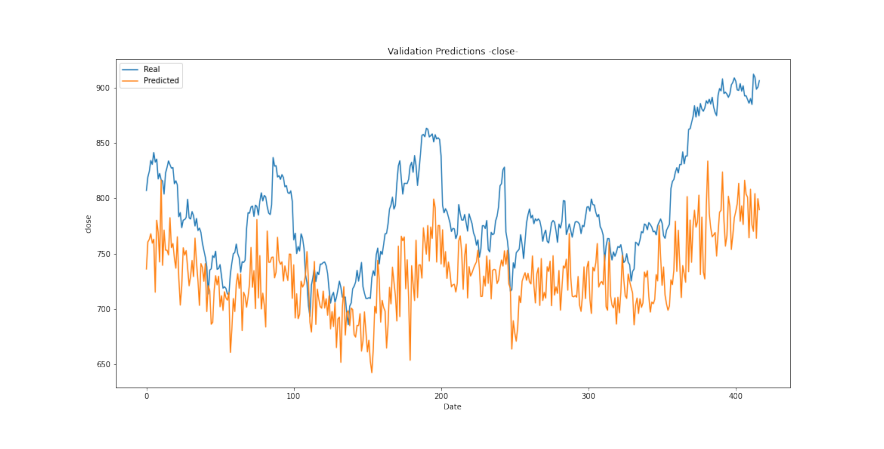

In [9]:
images = []
for epoch in range(num_epochs):
    if (epoch+1)%evaluation_epoch_num == 0 or epoch == 0 or epoch == (num_epochs-1):
        image_path = os.path.join('./plots_gru_disc/', f'validation_predictions_plt_close_e{epoch+1}.png')
        image = plt.imread(image_path)
        images.append(image)
#%%capture
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(16,8))
plt.axis("off")

all_images = [[plt.imshow(image, animated=True)] for image in images]
plt.rcParams['animation.embed_limit'] = 2**32
ani = animation.ArtistAnimation(fig, all_images, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

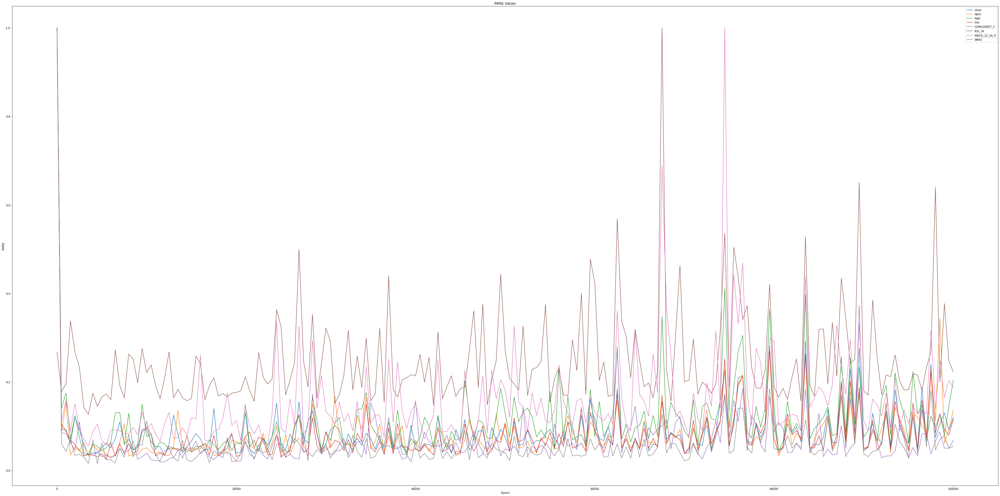

In [25]:
fig = plt.figure(figsize=(64,32))
plt.xlabel("Epoch")
plt.ylabel("RMSE")
plt.title("RMSE Values")
epoch_len = len(evaluation_metrics["rmse_values"][columns_used_in_training[0]])
x = [0] + [i for i in range(evaluation_epoch_num, evaluation_epoch_num*epoch_len, evaluation_epoch_num)]
# plt.ylim(0, 5)
for column in columns_used_in_training:
    y = evaluation_metrics["rmse_values"][column]
    y /= max(y)
    plt.plot(x, y,label=column)
plt.legend()
fig.savefig(f'./plots_gru_disc/rmse_all.png')
plt.show()
plt.close(fig)

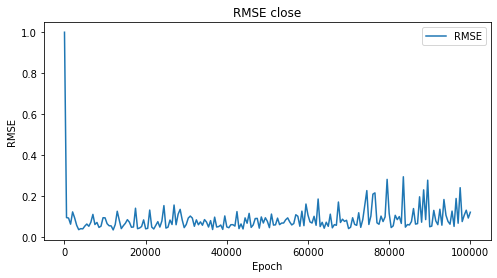

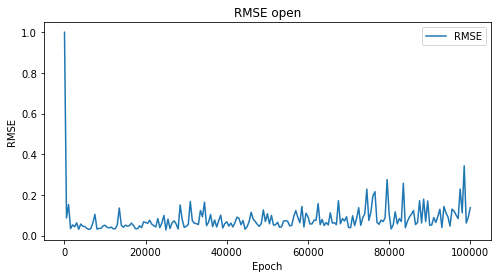

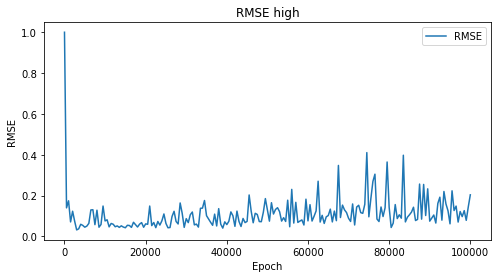

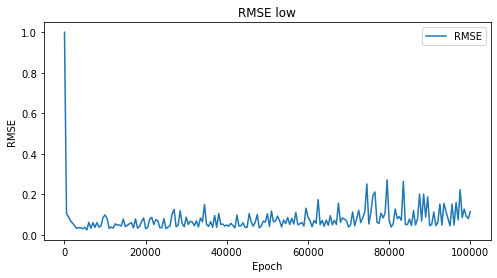

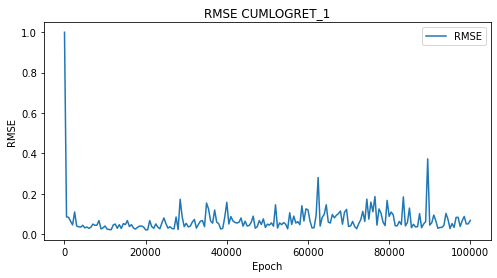

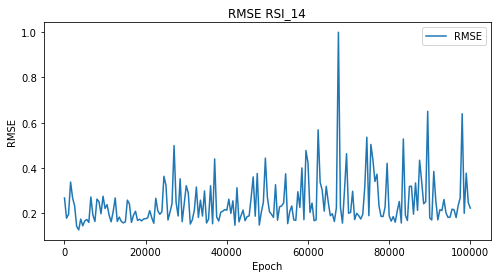

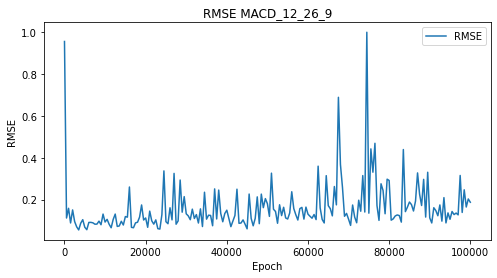

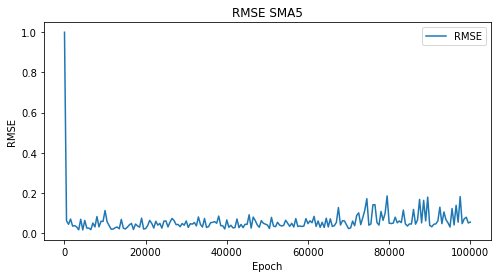

In [26]:
for column in columns_used_in_training:
    fig = plt.figure(figsize=(8,4))
    plt.xlabel("Epoch")
    plt.ylabel("RMSE")
    plt.title(f"RMSE {column}")
    epoch_len = len(evaluation_metrics["rmse_values"][columns_used_in_training[0]])
    x = [0] + [i for i in range(evaluation_epoch_num, evaluation_epoch_num*epoch_len, evaluation_epoch_num)]
    # plt.ylim(0, 5)
    y = evaluation_metrics["rmse_values"][column]
    y /= max(y)
    plt.plot(x, y,label="RMSE")
    plt.legend()
    fig.savefig(f'./plots_gru_disc/rmse_{column}.png')
    plt.show()
    plt.close(fig)

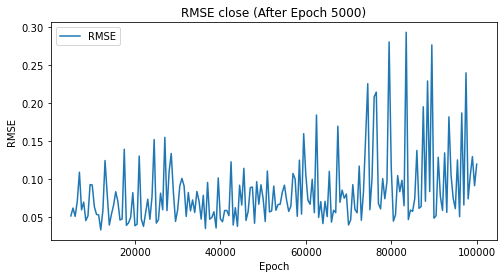

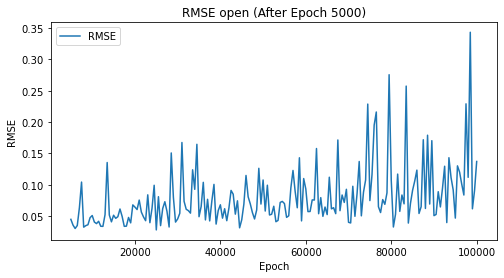

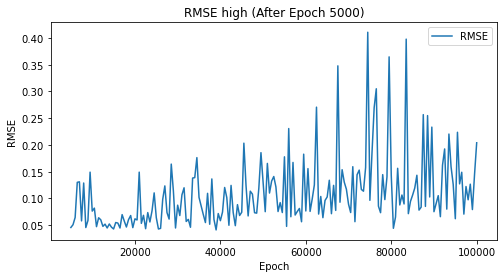

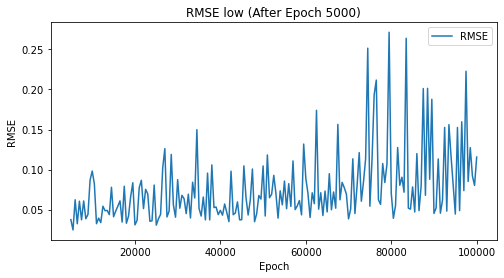

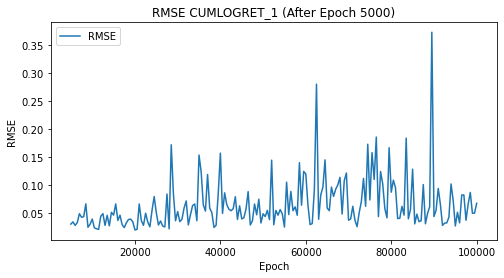

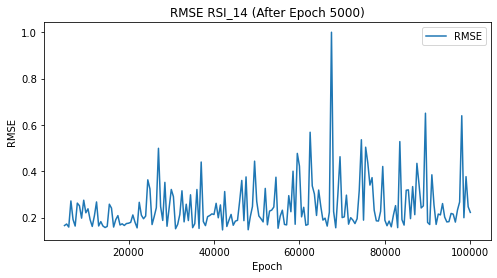

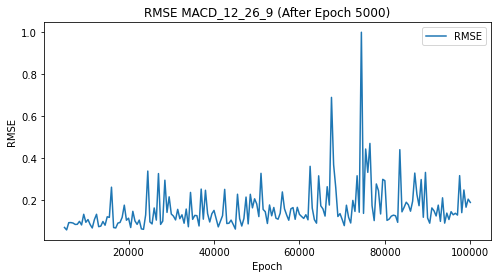

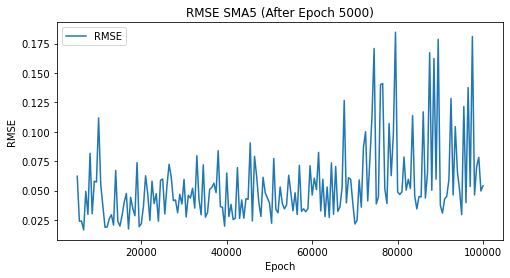

In [27]:
for column in columns_used_in_training:
    fig = plt.figure(figsize=(8,4))
    plt.xlabel("Epoch")
    plt.ylabel("RMSE")
    plt.title(f"RMSE {column} (After Epoch 5000)")
    epoch_len = len(evaluation_metrics["rmse_values"][columns_used_in_training[0]])
    x = [0] + [i for i in range(evaluation_epoch_num, evaluation_epoch_num*epoch_len, evaluation_epoch_num)]
    # plt.ylim(0, 5)
    y = evaluation_metrics["rmse_values"][column]
    y /= max(y)
    plt.plot(x[10:], y[10:],label="RMSE")
    plt.legend()
    fig.savefig(f'./plots_gru_disc/rmse_{column}.png')
    plt.show()
    plt.close(fig)

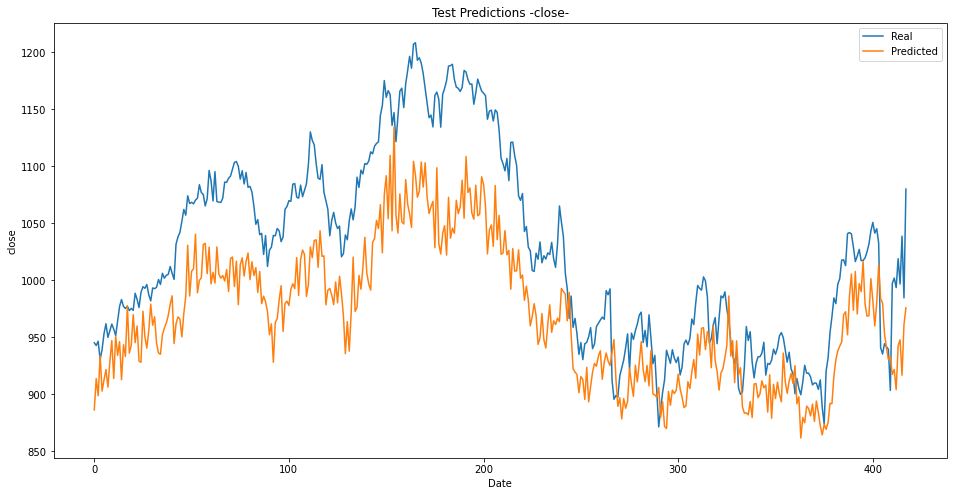

{'close': 66.58566129495013, 'open': 82.08550122561167, 'high': 97.43736564976582, 'low': 68.10564169169459, 'CUMLOGRET_1': 0.05243384470333721, 'RSI_14': 10.802585204730175, 'MACD_12_26_9': 5.645811940947806, 'SMA5': 48.57245899007854}


In [28]:
checkpoint = torch.load(os.path.join("./models_gru_disc/","model_epoch_{}.pt".format(best_predictor)))
generator.load_state_dict(checkpoint['generator_model_state_dict'])
rmse_values = model_rmse(generator, test_dataloader, epoch=best_predictor, plot_graph=True, plot_title="Test Predictions", show_preds=True)
print(rmse_values)

In [29]:
best_predictor

12000